In [2]:
import pandas as pd
from math import ceil

# plotting
import matplotlib.pyplot as plt
#import seaborn as sns

# handling trajectory and other geo-data
import geopandas as gpd
#import movingpandas as mpd
from shapely.geometry import Point, LineString, Polygon
from shapely.wkt import loads # to convert strings to shapely objects

# Some filepaths
points_file = '../Data/gbg_trajectories_points_2019.csv'
trajs_file = '../Data/gbg_trajectories_2019_crossing.csv'
points_pickle_file = '../Data/points.pkl'
trajs_pickle_file = '../Data/trajectories.pkl'

The data should exist as pre-pre-processed pickle files in the `Data` folder. If not, run the `create_dfs.py` script to generate them. The script loads both the trajectory and the point datasets into dataframes, converts timestamp strings to datetime objects, and saves the dataframes as pickle files for loading into notebooks. It also downcasts integer columns to save some memory.

In [3]:
# Load data into pandas
points_df = pd.read_pickle(points_pickle_file)
trajs_df = pd.read_pickle(trajs_pickle_file)

In [4]:
trajs_df.info(), points_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2484058 entries, 6 to 24848723
Data columns (total 7 columns):
 #   Column       Dtype  
---  ------       -----  
 0   start_time   object 
 1   stop_time    object 
 2   duration     uint32 
 3   data_points  uint32 
 4   distance     uint32 
 5   speed        float64
 6   line         object 
dtypes: float64(1), object(3), uint32(3)
memory usage: 123.2+ MB
<class 'pandas.core.frame.DataFrame'>
MultiIndex: 17566894 entries, (15556967, 6) to (15556902, 24848723)
Data columns (total 4 columns):
 #   Column          Dtype  
---  ------          -----  
 0   x               float64
 1   y               float64
 2   timestamp       object 
 3   trajectory_sid  uint32 
dtypes: float64(2), object(1), uint32(1)
memory usage: 756.4+ MB


(None, None)

In [5]:
display(trajs_df.head())
display(points_df.head())

,start_time,stop_time,duration,data_points,distance,speed,line
sid,,,,,,,
6,2019-12-14 11:27:32+01:00,2019-12-14 11:27:47+01:00,15,2,28,6.72,LINESTRING (323561.5344531308 6408021.19879876...
7,2019-12-14 12:34:00+01:00,2019-12-14 12:34:15+01:00,15,2,50,12.00,LINESTRING (323539.49932727637 6408003.3921408...
8,2019-09-02 10:13:10+02:00,2019-09-02 10:13:25+02:00,15,2,57,13.68,LINESTRING (323606.27461098554 6408043.0377496...
9,2019-09-02 15:57:22+02:00,2019-09-02 15:57:27+02:00,5,2,36,25.92,LINESTRING (323558.83476843353 6408013.4133455...
10,2019-09-02 16:30:57+02:00,2019-09-02 16:31:05+02:00,8,2,35,15.75,LINESTRING (323559.45531584776 6408011.2680359...


,,x,y,timestamp,trajectory_sid
,trajectory_sid,,,,
15556967,6,323561.534453,6.408021e+06,2019-12-14 11:27:32+01:00,6
15556966,6,323539.411465,6.408003e+06,2019-12-14 11:27:47+01:00,6
15556969,7,323539.499327,6.408003e+06,2019-12-14 12:34:00+01:00,7
15556968,7,323514.312790,6.408047e+06,2019-12-14 12:34:15+01:00,7
106,8,323606.274611,6.408043e+06,2019-09-02 10:13:10+02:00,8


In [6]:
display(trajs_df[trajs_df.index == 12])
display(points_df.xs(12, level='trajectory_sid'))

,start_time,stop_time,duration,data_points,distance,speed,line
sid,,,,,,,
12,2019-09-03 09:42:27+02:00,2019-09-03 09:42:42+02:00,15,2,27,6.480000,LINESTRING (323549.9825152642 6408015.25078328...
12,2019-12-20 13:48:54+01:00,2019-12-20 13:49:31+01:00,37,2,202,19.654054,LINESTRING (323561.88104965806 6408010.9052586...


,x,y,timestamp,trajectory_sid
29,323549.982515,6.408015e+06,2019-09-03 09:42:27+02:00,12
30,323572.805815,6.408001e+06,2019-09-03 09:42:42+02:00,12
15556964,323561.881050,6.408011e+06,2019-12-20 13:48:54+01:00,12
15556965,323394.195869,6.407899e+06,2019-12-20 13:49:31+01:00,12


In [7]:
trajs_df.index.value_counts()[:79000]

sid
200119     3
297319     3
1522836    3
1522845    3
1522846    3
          ..
2606513    2
2606512    2
198885     2
259520     2
2724862    2
Name: count, Length: 79000, dtype: int64

In [8]:
# Load data into geodataframes
points_gdf = gpd.GeoDataFrame(points_df, geometry=gpd.points_from_xy(points_df.x, points_df.y), crs = 'EPSG:3006')
trajs_gdf = gpd.GeoDataFrame(trajs_df, geometry='line', crs='EPSG:3006')

In [9]:
del points_df
del trajs_df

In [10]:
display(points_gdf.head()), display(trajs_gdf.head())

,,x,y,timestamp,trajectory_sid,geometry
,trajectory_sid,,,,,
15556967,6,323561.534453,6.408021e+06,2019-12-14 11:27:32+01:00,6,POINT (323561.534 6408021.199)
15556966,6,323539.411465,6.408003e+06,2019-12-14 11:27:47+01:00,6,POINT (323539.411 6408003.385)
15556969,7,323539.499327,6.408003e+06,2019-12-14 12:34:00+01:00,7,POINT (323539.499 6408003.392)
15556968,7,323514.312790,6.408047e+06,2019-12-14 12:34:15+01:00,7,POINT (323514.313 6408046.754)
106,8,323606.274611,6.408043e+06,2019-09-02 10:13:10+02:00,8,POINT (323606.275 6408043.038)


,start_time,stop_time,duration,data_points,distance,speed,line
sid,,,,,,,
6,2019-12-14 11:27:32+01:00,2019-12-14 11:27:47+01:00,15,2,28,6.72,"LINESTRING (323561.534 6408021.199, 323539.411..."
7,2019-12-14 12:34:00+01:00,2019-12-14 12:34:15+01:00,15,2,50,12.00,"LINESTRING (323539.499 6408003.392, 323514.313..."
8,2019-09-02 10:13:10+02:00,2019-09-02 10:13:25+02:00,15,2,57,13.68,"LINESTRING (323606.275 6408043.038, 323558.422..."
9,2019-09-02 15:57:22+02:00,2019-09-02 15:57:27+02:00,5,2,36,25.92,"LINESTRING (323558.835 6408013.413, 323524.850..."
10,2019-09-02 16:30:57+02:00,2019-09-02 16:31:05+02:00,8,2,35,15.75,"LINESTRING (323559.455 6408011.268, 323527.697..."


(None, None)

In [11]:
trajs_gdf.info(), points_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 2484058 entries, 6 to 24848723
Data columns (total 7 columns):
 #   Column       Dtype   
---  ------       -----   
 0   start_time   object  
 1   stop_time    object  
 2   duration     uint32  
 3   data_points  uint32  
 4   distance     uint32  
 5   speed        float64 
 6   line         geometry
dtypes: float64(1), geometry(1), object(2), uint32(3)
memory usage: 123.2+ MB
<class 'geopandas.geodataframe.GeoDataFrame'>
MultiIndex: 17566894 entries, (15556967, 6) to (15556902, 24848723)
Data columns (total 5 columns):
 #   Column          Dtype   
---  ------          -----   
 0   x               float64 
 1   y               float64 
 2   timestamp       object  
 3   trajectory_sid  uint32  
 4   geometry        geometry
dtypes: float64(2), geometry(1), object(1), uint32(1)
memory usage: 890.4+ MB


(None, None)

Since we are only interested in segments in Gothenburg, we will truncate the trajectories as they pass the city's boundaries. We will do this by first computing a boolean for every point whether it is inside the boundary (on the points df), then we iterate over every trajectory to define new starting and ending points.

There is a small risk that some trajectories that exit and return for example, will be cut into two new trajectories. This will not impact our investigations.

In [13]:
# importing the city boundary geometry
gbg_boundary = gpd.read_file('../Data/city_municipality_poly.geojson')
#city_boundary_idx = city_boundary.sindex

<Axes: >

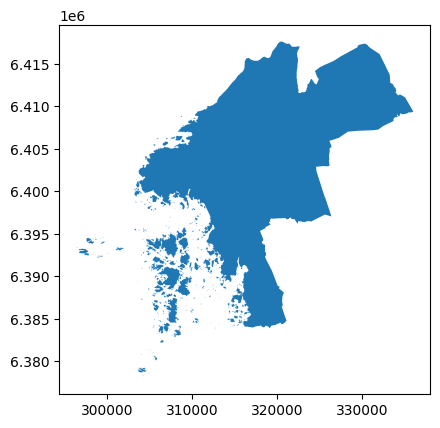

In [14]:
gbg_boundary.plot()

In [14]:
# trajs_gdf = trajs_gdf.sample(1000000, random_state=42)
# points_gdf = points_gdf.sample(1000000, random_state=42).sort_values('x')

In [15]:
# To leverage the spatial index of a gdf, we do a spatial join of the points gdf and 
# the boundary gdf with the predicate 'within'.
# This appends information from the boundary if the point is within the boundary.
# In that case the new column 'index_right' will have a non-nan value
# runtime 6+ minutes
joined_gdf = gpd.sjoin(gbg_boundary, points_gdf, how='right', predicate='covers')
points_gdf['within_boundary'] = joined_gdf['index_left'].notna()
del joined_gdf # to save memory
points_gdf.sample(5)

,,x,y,timestamp,trajectory_sid,geometry,within_boundary
,trajectory_sid,,,,,,
3513719,5017099,324355.348876,6.411554e+06,2019-10-13 18:45:12+02:00,5017099,POINT (324355.349 6411553.879),True
16493031,1049366,320391.932752,6.402768e+06,2019-12-15 14:52:09+01:00,1049366,POINT (320391.933 6402768.219),True
2874029,4130171,318892.646165,6.419958e+06,2019-09-22 11:36:54+02:00,4130171,POINT (318892.646 6419957.784),False
672184,906524,334922.453567,6.340801e+06,2019-09-21 23:03:23+02:00,906524,POINT (334922.454 6340801.006),False
107566,121588,321922.420275,6.416891e+06,2019-09-08 13:35:57+02:00,121588,POINT (321922.420 6416890.738),True


<Axes: >

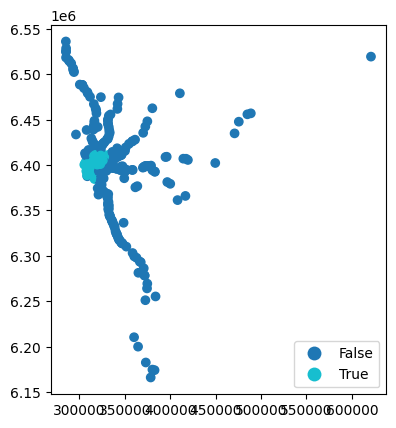

In [16]:
points_gdf.sample(1000).plot(column='within_boundary', legend=True)

In [19]:
# filter the trajectories that have points outside the boundary
trajs_to_truncate = points_gdf[points_gdf['within_boundary'] == False]['trajectory_sid'].unique()
trajs_to_truncate, len(trajs_to_truncate)

(array([     105,      106,      107, ..., 24848405, 24848656, 24848657],
       dtype=uint32),
 398901)

It takes many hours to process almost 400,000 trajectories, perhaps we can make this list much smaller. For example by only considering trajectories that have more than a certain ratio of points outside the city, the higher the ratio the more we gain by truncating it.

In [20]:
trajs_T_F = points_gdf[points_gdf.trajectory_sid.isin(trajs_to_truncate)].groupby(points_gdf.trajectory_sid)

In [55]:
trajs_gdf['num_points_within_boundary'] = trajs_T_F.within_boundary.sum()
trajs_gdf['ratio_points_within'] = trajs_gdf.num_points_within_boundary / trajs_gdf.data_points
trajs_gdf['num_points_outside_boundary'] = trajs_gdf.data_points - trajs_T_F.within_boundary.sum()

In [64]:
trajs_gdf[(trajs_gdf.num_points_outside_boundary > 5) | (trajs_gdf.num_points_within_boundary == 0)]

,start_time,stop_time,duration,data_points,distance,speed,line,num_points_within_boundary,ratio_points_within,num_points_outside_boundary
sid,,,,,,,,,,
397,2019-12-27 02:29:36+01:00,2019-12-27 02:30:07+01:00,31,2,366,42.503226,"LINESTRING (328142.966 6402966.221, 327841.521...",0.0,0.0,2.0
398,2019-12-27 02:56:09+01:00,2019-12-27 03:12:28+01:00,979,3,752,2.765271,"LINESTRING (327844.349 6402757.117, 328142.018...",0.0,0.0,3.0
399,2019-12-27 03:22:39+01:00,2019-12-27 03:40:44+01:00,1085,3,755,2.505069,"LINESTRING (327839.564 6402760.810, 328142.018...",0.0,0.0,3.0
1185,2019-12-31 16:56:05+01:00,2019-12-31 16:56:10+01:00,5,2,26,18.720000,"LINESTRING (323133.818 6394924.586, 323144.255...",0.0,0.0,2.0
1441,2019-07-19 13:26:25+02:00,2019-07-19 13:26:36+02:00,11,2,113,36.981818,"LINESTRING (324060.341 6384790.674, 324097.621...",0.0,0.0,2.0
...,...,...,...,...,...,...,...,...,...,...
24848341,2019-07-27 07:54:08+02:00,2019-07-27 07:54:21+02:00,13,2,306,84.738462,"LINESTRING (328870.693 6403372.672, 328565.192...",0.0,0.0,2.0
24848345,2019-07-27 08:08:09+02:00,2019-07-27 08:08:31+02:00,22,2,598,97.854545,"LINESTRING (323552.832 6388997.438, 323816.879...",0.0,0.0,2.0
24848405,2019-07-30 07:03:24+02:00,2019-07-30 07:03:59+02:00,35,2,446,45.874286,"LINESTRING (322594.912 6392156.464, 322999.245...",0.0,0.0,2.0


In [33]:
trajs_dict
num_zeros = 0
num_ones = 0
prev_traj_id = None
for (traj_id, label), number in trajs_T_F.within_boundary.value_counts().items():
    if label is True:
        num_true = number

    else:
        num_false = number
    prev_traj_id = traj_id

105 False 3
105 True 2
106 True 2
106 False 2
107 False 3
107 True 2
397 False 2
398 False 3
399 False 3
1095 False 2
1095 True 1
1096 True 1
1096 False 1
1110 False 2
1110 True 1
1115 False 2
1115 True 1
1116 False 1
1116 True 1
1134 False 2
1134 True 1
1135 False 2
1135 True 1
1143 True 1
1143 False 1
1144 False 1
1144 True 1
1145 False 1
1145 True 1
1162 False 1
1162 True 1
1167 False 1
1167 True 1
1176 True 1
1176 False 1
1179 False 2
1179 True 1
1180 True 1
1180 False 1
1185 False 2
1441 False 2
1507 False 2
1508 False 2
1512 False 2
1513 False 2
1514 False 3
1515 False 3
1516 False 2
1518 False 2
1533 False 3
1534 False 4
1535 False 2
1537 False 2
1540 False 3
1544 False 4
1545 False 2
1548 False 2
1549 False 5
1550 False 3
1551 False 2
1552 False 2
1554 False 4
1563 True 5
1563 False 1
1564 False 5
1567 True 2
1567 False 2
1572 False 2
1574 False 2
1575 False 3
1578 False 2
1579 False 3
1580 False 5
1587 False 2
1590 False 3
1590 True 2
1591 False 3
1595 False 3
1596 False 2
160

In [24]:
points_gdf.xs(24848341, level='trajectory_sid')

,x,y,timestamp,trajectory_sid,geometry,within_boundary
15556912,328870.693415,6.403373e+06,2019-07-27 07:54:08+02:00,24848341,POINT (328870.693 6403372.672),False
15556913,328565.191739,6.403351e+06,2019-07-27 07:54:21+02:00,24848341,POINT (328565.192 6403351.123),False


In [90]:
for val, cnt in trajs_T_F.items():
    print(val, cnt)

(105, False) 3
(105, True) 2
(106, True) 2
(106, False) 2
(107, False) 3
(107, True) 2
(397, False) 2
(398, False) 3
(399, False) 3
(1095, False) 2
(1095, True) 1
(1096, True) 1
(1096, False) 1
(1110, False) 2
(1110, True) 1
(1115, False) 2
(1115, True) 1
(1116, False) 1
(1116, True) 1
(1134, False) 2
(1134, True) 1
(1135, False) 2
(1135, True) 1
(1143, True) 1
(1143, False) 1
(1144, False) 1
(1144, True) 1
(1145, False) 1
(1145, True) 1
(1162, False) 1
(1162, True) 1
(1167, False) 1
(1167, True) 1
(1176, True) 1
(1176, False) 1
(1179, False) 2
(1179, True) 1
(1180, True) 1
(1180, False) 1
(1185, False) 2
(1441, False) 2
(1507, False) 2
(1508, False) 2
(1512, False) 2
(1513, False) 2
(1514, False) 3
(1515, False) 3
(1516, False) 2
(1518, False) 2
(1533, False) 3
(1534, False) 4
(1535, False) 2
(1537, False) 2
(1540, False) 3
(1544, False) 4
(1545, False) 2
(1548, False) 2
(1549, False) 5
(1550, False) 3
(1551, False) 2
(1552, False) 2
(1554, False) 4
(1563, True) 5
(1563, False) 1
(156

In [70]:
for traj_sid in trajs_to_truncate[:3]:
    traj_points = points_gdf.xs(traj_sid, level='trajectory_sid')
    display(traj_points.within_boundary.value_counts())

within_boundary
False    3
True     2
Name: count, dtype: int64

within_boundary
True     2
False    2
Name: count, dtype: int64

within_boundary
False    3
True     2
Name: count, dtype: int64

In [71]:
# We will iterate over the trajectories that cross the border and keep track
# of the state of within_boundary and add points to new subset trajectories accordingly.
# We will store the new trajectories in a dictionary with the old trajectory id as key.
new_trajectories = {} #{old_traj_id: [[point_indexes_in_new_trajectory1],[...2],...]

num_trajs_to_truncate = len(trajs_to_truncate)
num_trajs_truncated = 0
print('Number of trjectories to truncate: ', num_trajs_to_truncate)
for traj_sid in trajs_to_truncate:
    print('truncating trajectory: ', traj_sid,'...', end=' ')
    # initiate variables for collecting points in new trajectories
    new_trajectories[traj_sid] = []
    current_trajectory = []
    prev_within_boundary = None
    previous_idx = None
    # filter the points of the trajectory
    traj_points = points_gdf.xs(traj_sid, level='trajectory_sid')
    for idx, row in traj_points.iterrows():
        if row.within_boundary:
            if prev_within_boundary == False:
                # add the previous point to the new trajectory to keep
                # the trajectory crossing the border
                current_trajectory.append(previous_idx)
            current_trajectory.append(idx)
        elif len(current_trajectory) > 0:
            # add the current point to keep the trajectory crossing the border
            current_trajectory.append(idx)
            # store the trajectory in the dictionary
            new_trajectories[traj_sid].append(current_trajectory)
            # reset the current trajectory
            current_trajectory = []
        prev_within_boundary = row.within_boundary
        previous_idx = idx
    # if the last point was within the boundary we will have a current_trajectory
    # that we also save
    if len(current_trajectory) > 0:
        new_trajectories[traj_sid].append(current_trajectory)
    num_trajs_to_truncate -= 1
    num_trajs_truncated += 1
    print('Done. {} truncated, {} remaining.'.format(num_trajs_truncated, num_trajs_to_truncate))    

Number of trjectories to truncate:  398901
truncating trajectory:  105 ... Done. 1 truncated, 398900 remaining.
truncating trajectory:  106 ... Done. 2 truncated, 398899 remaining.
truncating trajectory:  107 ... Done. 3 truncated, 398898 remaining.
truncating trajectory:  397 ... Done. 4 truncated, 398897 remaining.
truncating trajectory:  398 ... Done. 5 truncated, 398896 remaining.
truncating trajectory:  399 ... Done. 6 truncated, 398895 remaining.
truncating trajectory:  1095 ... Done. 7 truncated, 398894 remaining.
truncating trajectory:  1096 ... Done. 8 truncated, 398893 remaining.
truncating trajectory:  1110 ... Done. 9 truncated, 398892 remaining.
truncating trajectory:  1115 ... Done. 10 truncated, 398891 remaining.
truncating trajectory:  1116 ... Done. 11 truncated, 398890 remaining.
truncating trajectory:  1134 ... Done. 12 truncated, 398889 remaining.
truncating trajectory:  1135 ... Done. 13 truncated, 398888 remaining.
truncating trajectory:  1143 ... Done. 14 truncat

KeyboardInterrupt: 

5 minutes to process 8000 trajectories. over 390000 to go. Approximately 96000 trajectories per hour. Need to make that list smaller.

In [ ]:
# save the 10 first trajectories to a csv-file to check them in QGIS
traj_sids = list(new_trajectories.keys())


In [65]:
for key, trajs in new_trajectories.items():
    print(key, len(trajs))

18065953 2
12056809 1
22667239 1
20958050 1
2077674 4
19051005 0
3901753 1
6886530 2
20709366 1
24398373 2


# Data driven trajectory cleaning